In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn import metrics
import math
import pickle
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.figure_factory as ff
from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering


Most of our features are already in the range of 1 to 0.
but we standardize the data around the mean of the range of 1.5% to 98.5% of our data
this is to prevent outliers from influencing the scaling too much.
the ignored 4% will fall out of the 0.5 to -0.5 range but are not removed;
to curb the influence of these rows even more, we exponentially
slow down the further it gets from 1 (0) and keep them closer to 1 (0)

In [2]:
df=pd.read_csv("src_data/genres_v2.csv").drop_duplicates()
df.set_index('id',inplace=True)
df_genre=df['genre']
df.drop(['Unnamed: 0','title','analysis_url','track_href','uri',
         'type','song_name','genre'],
        axis=1,inplace=True)

print('before standardization and ignoring the 4%')
df.describe()

before standardization and ignoring the 4%


D:\Ext. App Files\Code\Py\DataScience\Venv_Conda\Lib\site-packages\IPython\core\interactiveshell.py:3457: DtypeWarning: Columns (19) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000
mean,0.639364,0.762516,5.370240,-6.465442,0.549462,0.136561,0.096160,0.283048,0.214079,0.357101,147.474056,250865.846685,3.972580
std,0.156617,0.183823,3.666145,2.941165,0.497553,0.126168,0.170827,0.370791,0.175576,0.233200,23.844623,102957.713571,0.268342
min,0.065100,0.000243,0.000000,-33.357000,0.000000,0.022700,0.000001,0.000000,0.010700,0.018700,57.967000,25600.000000,1.000000
25%,0.524000,0.632000,1.000000,-8.161000,0.000000,0.049100,0.001730,0.000000,0.099600,0.161000,129.931000,179840.000000,4.000000
50%,0.646000,0.803000,6.000000,-6.234000,1.000000,0.075500,0.016400,0.005940,0.135000,0.322000,144.973000,224760.000000,4.000000
75%,0.766000,0.923000,9.000000,-4.513000,1.000000,0.193000,0.107000,0.722000,0.294000,0.522000,161.464000,301133.000000,4.000000
max,0.988000,1.000000,11.000000,3.148000,1.000000,0.946000,0.988000,0.989000,0.988000,0.988000,220.290000,913052.000000,5.000000


In [3]:
perc=np.array([98.5,1.5])
df_mm=df.describe(percentiles=perc/100)
df_mm=[df_mm.loc[str(perc[1])+'%',:],
       df_mm.loc[str(perc[0])+'%',:]-df_mm.loc[str(perc[1])+'%',:]]
df=df.apply(lambda col: (col-df_mm[0][col.name])/df_mm[1][col.name])-0.5

print('after standardization and ignoring the 4%')
df.describe()

after standardization and ignoring the 4%


,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000
mean,0.055257,0.160052,-0.011796,0.068705,0.049462,-0.271992,-0.371644,-0.197922,-0.275598,-0.125174,-0.070839,-0.129665,0.472580
std,0.244714,0.271126,0.333286,0.224457,0.497553,0.270979,0.228081,0.395722,0.232414,0.272558,0.240741,0.249232,0.268342
min,-0.842031,-0.964243,-0.500000,-1.983546,-0.500000,-0.516538,-0.500032,-0.500000,-0.544816,-0.520687,-0.974523,-0.674970,-2.500000
25%,-0.125000,-0.032448,-0.409091,-0.060692,-0.500000,-0.459837,-0.497724,-0.500000,-0.427137,-0.354371,-0.247957,-0.301598,0.500000
50%,0.065625,0.219764,0.045455,0.086368,0.500000,-0.403136,-0.478137,-0.493661,-0.380277,-0.166199,-0.096090,-0.192860,0.500000
75%,0.253125,0.396755,0.318182,0.217708,0.500000,-0.150773,-0.357172,0.270544,-0.169805,0.067555,0.070407,-0.007982,0.500000
max,0.600000,0.510324,0.500000,0.802363,0.500000,1.466495,0.819103,0.555496,0.748860,0.612202,0.664329,1.473301,1.500000


In [4]:
max_v,min_v=0.5,-0.5
df=df.apply(lambda col: col.apply(lambda v: v if np.isscalar(v) and max_v>=v>=min_v
                                        else np.sign(v)*math.log(abs(v*8)+1,5)/2))
print('after curbing the influence of the outliers')
df.describe()

after curbing the influence of the outliers


,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000,42305.000000
mean,0.055670,0.160985,-0.011796,0.069674,0.049462,-0.274042,-0.372730,-0.198042,-0.276430,-0.125508,-0.070175,-0.130294,0.469631
std,0.242500,0.268207,0.333286,0.218155,0.497553,0.262406,0.223237,0.395502,0.228769,0.271617,0.236162,0.245918,0.190697
min,-0.635600,-0.672572,-0.500000,-0.877772,-0.500000,-0.508114,-0.500016,-0.500000,-0.521514,-0.510116,-0.675490,-0.576680,-0.945834
25%,-0.125000,-0.032448,-0.409091,-0.060692,-0.500000,-0.459837,-0.497724,-0.500000,-0.427137,-0.354371,-0.247957,-0.301598,0.500000
50%,0.065625,0.219764,0.045455,0.086368,0.500000,-0.403136,-0.478137,-0.493661,-0.380277,-0.166199,-0.096090,-0.192860,0.500000
75%,0.253125,0.396755,0.318182,0.217708,0.500000,-0.150773,-0.357172,0.270544,-0.169805,0.067555,0.070407,-0.007982,0.500000
max,0.546109,0.505090,0.500000,0.622587,0.500000,0.790374,0.628145,0.526429,0.604126,0.551294,0.572520,0.791700,0.796846


In [5]:
# we add genre and remove extra var
df['genre']=df_genre
del df_mm, perc

a general box plot of all our features below:

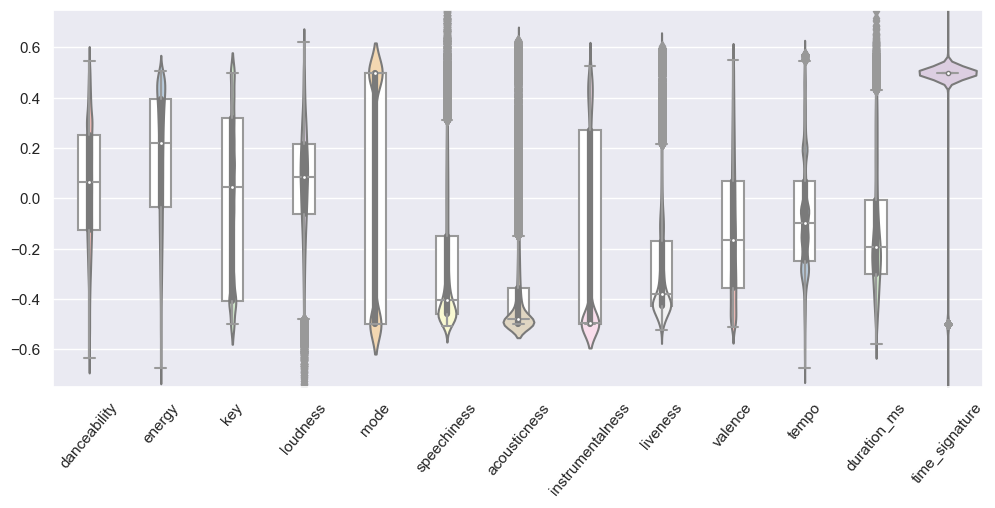

In [6]:
plt.figure(figsize=(12,5), dpi=100)
sns.set(style="darkgrid")
sns.violinplot(data=df, palette="Pastel1", width=0.8)
sns.boxplot(data=df, color="white", width=0.3)
plt.xticks(rotation=50)
plt.ylim(min_v-0.25,max_v+0.25)
plt.show()

box plot of genres with respect to different features because
we expect a grouping based on genre to be decisive factor since we humans
tend to choose based on genre, and they seem to be a good summery

a few takeouts:

    duration seems to vary in genres with psytrance being the longest

    tempo seems to vary significantly in genres with psytrance being the longest

    **IMPORTANT**: some features such as speechiness, acousticness, instrumentalness
     and temp seem to vary slightly variance for many of the genre BUT not all of them.
     some of genres. some of the genres have a wider range of values in these features
     (for example: trancce in intrumentalness has a much wider variation compared to the rest)

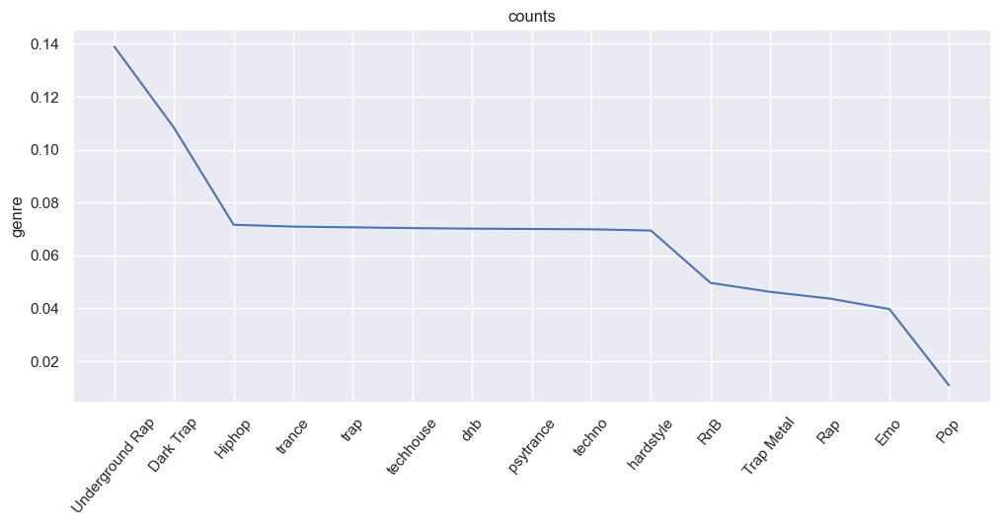

In [7]:
cols_order=df_genre.value_counts().index
plt.figure(figsize=(12,5), dpi=100)
sns.set(style="darkgrid")
sns.lineplot(x=cols_order, y=df_genre.value_counts()/len(df))
plt.xticks(rotation=50)
plt.title('counts')
plt.show()

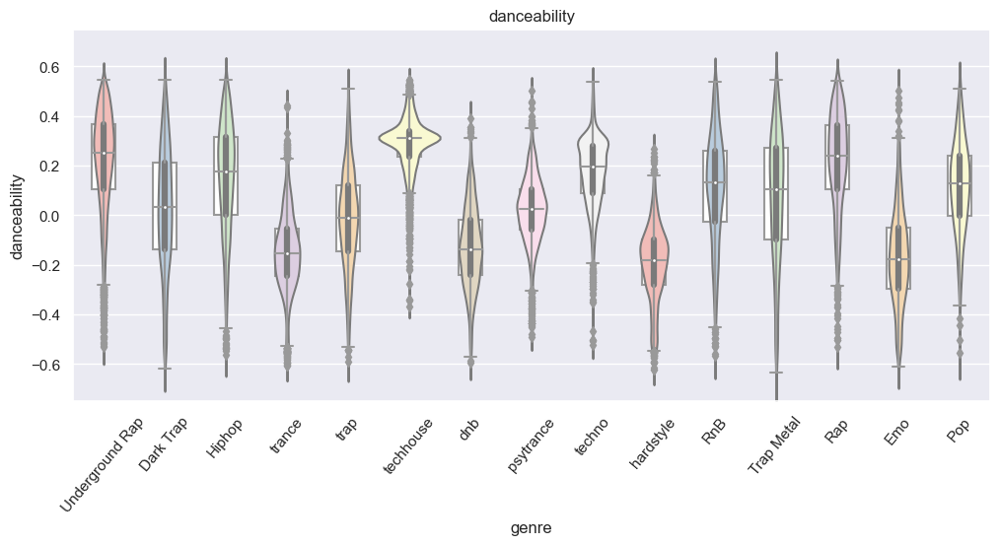

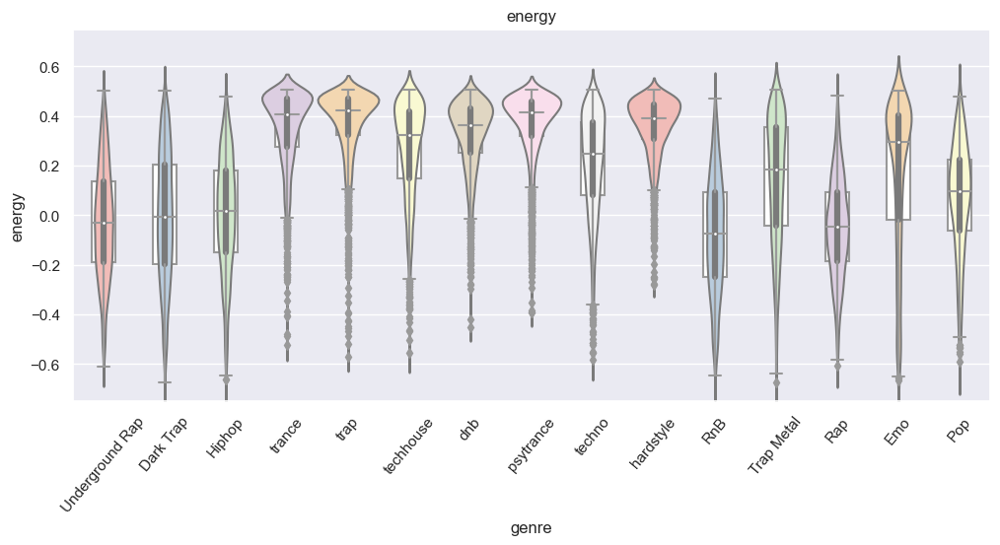

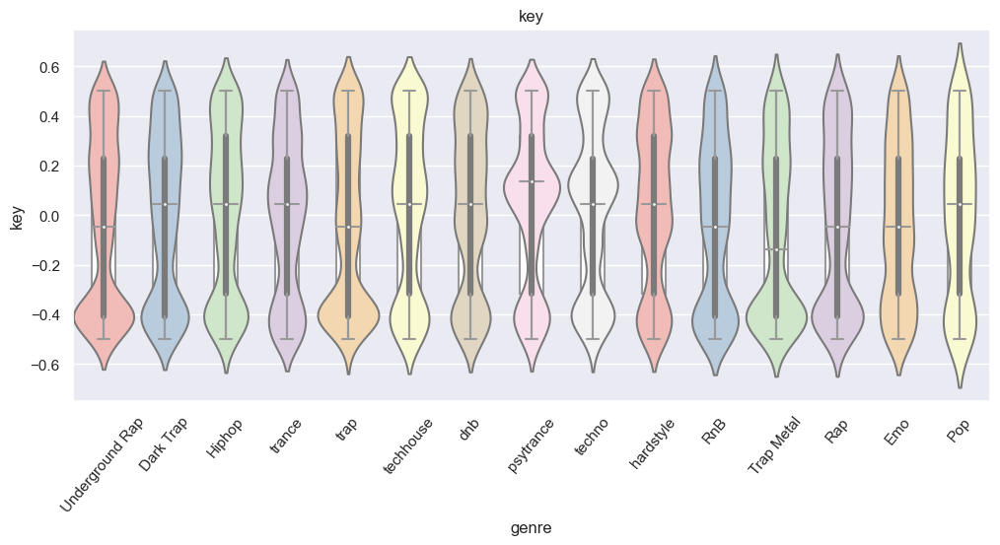

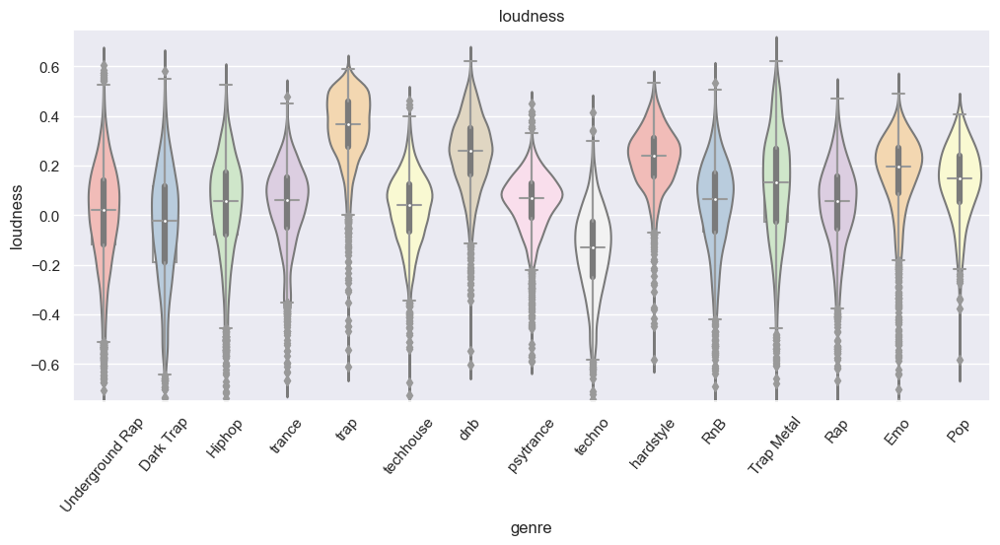

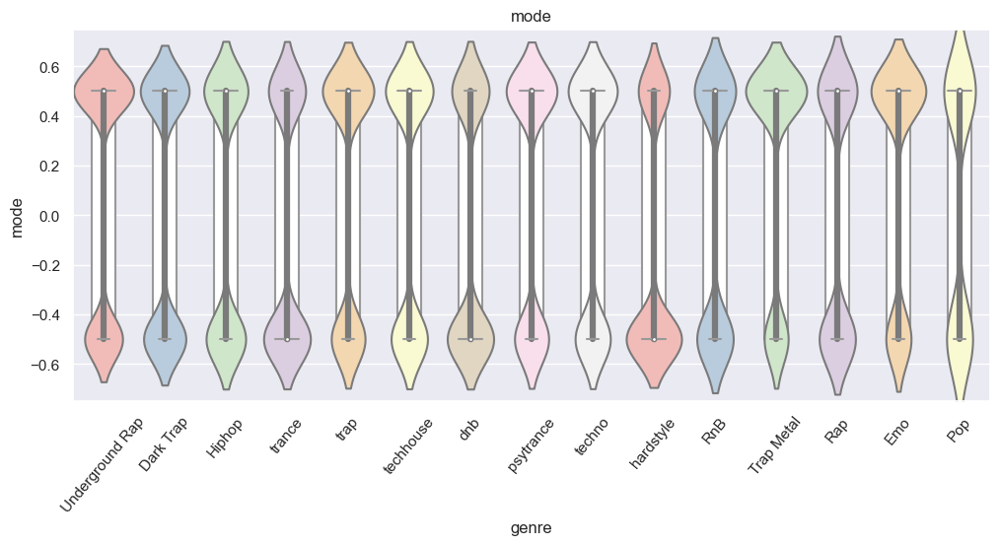

...

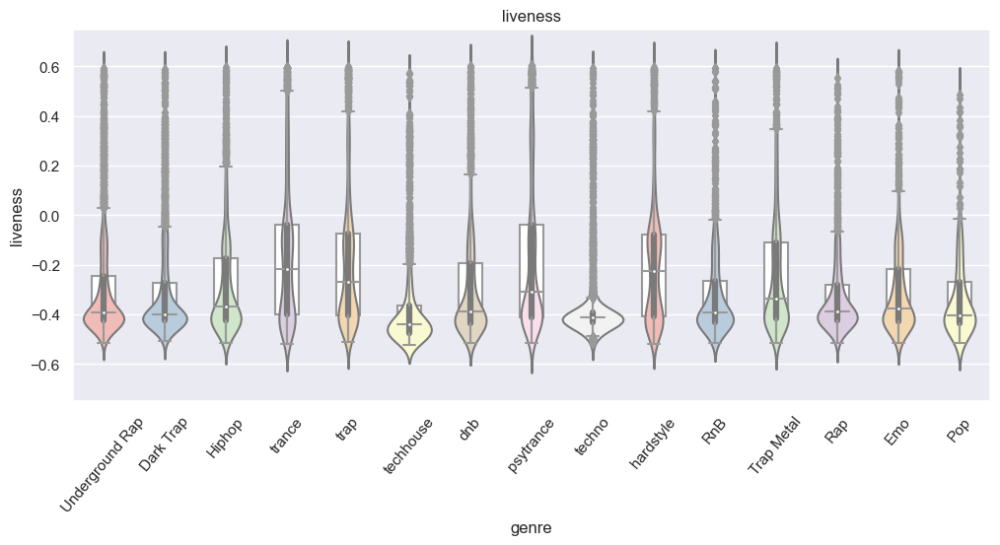

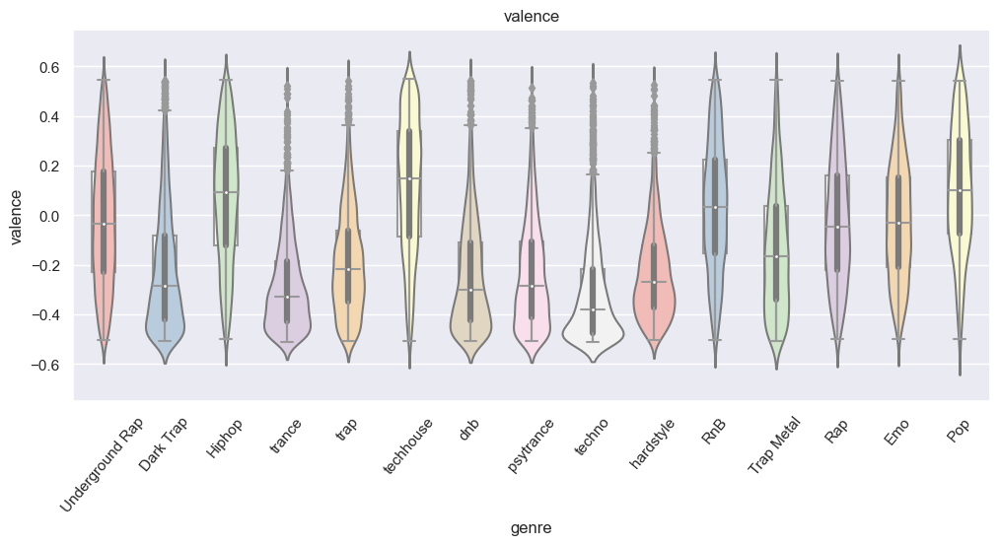

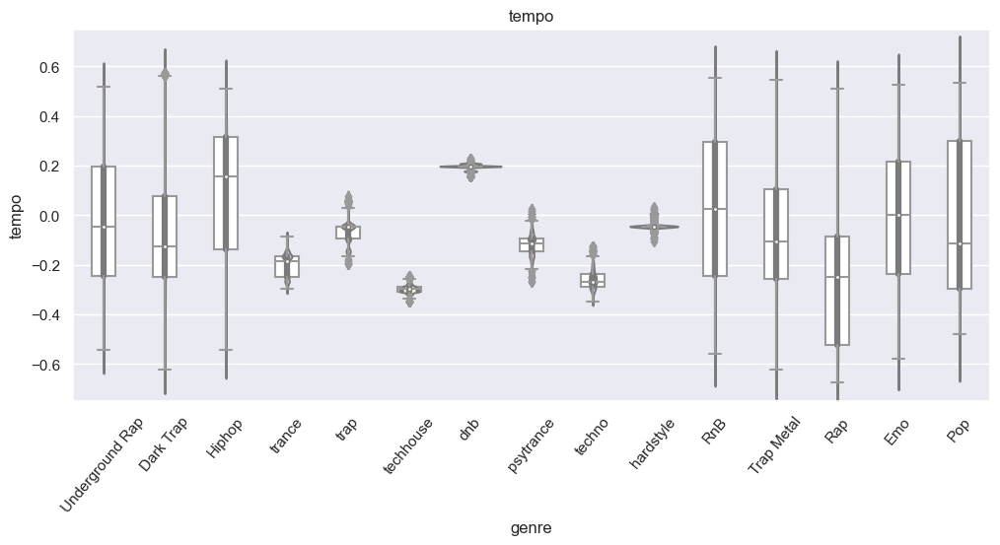

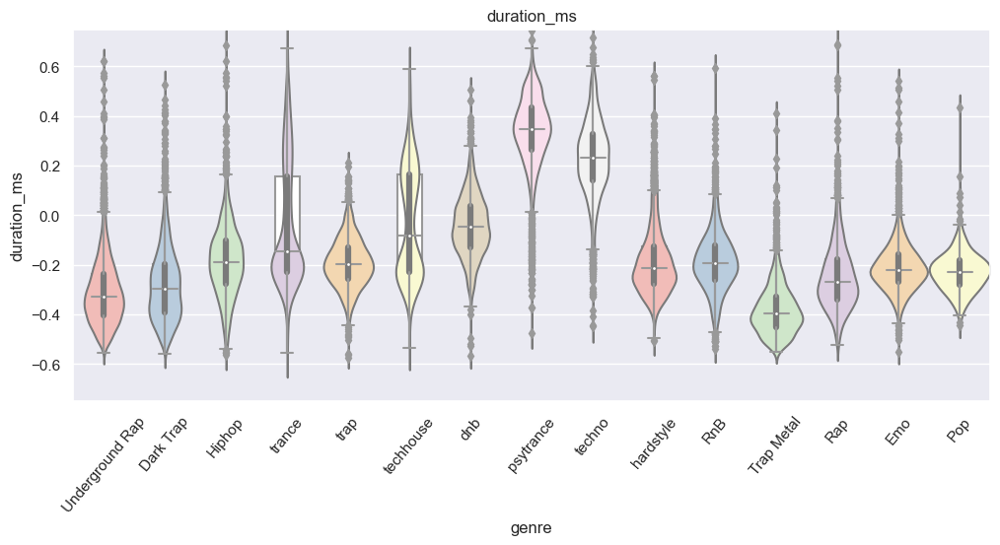

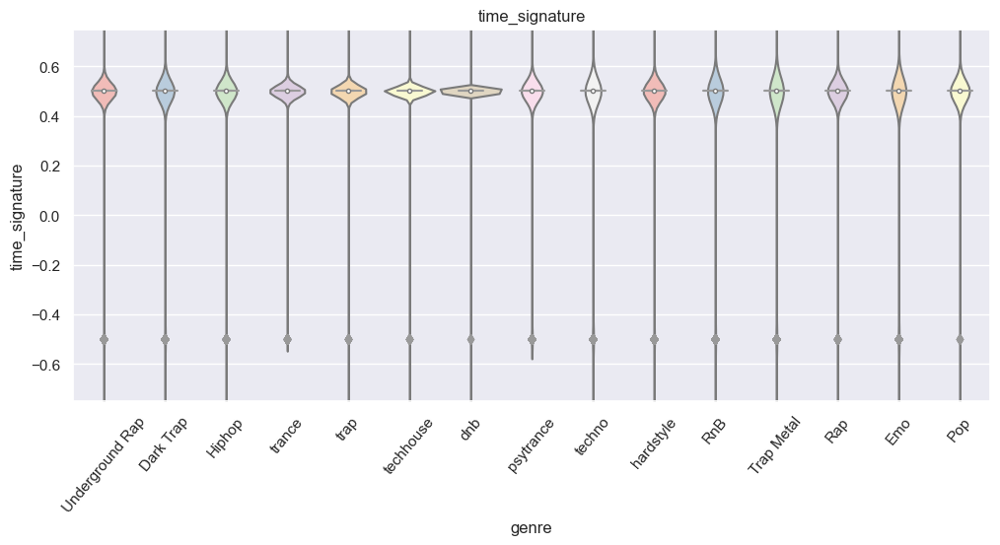

In [8]:
for y in df.columns[:-1]:
    plt.figure(figsize=(12,5), dpi=100)
    sns.set(style="darkgrid")
    x=df_genre
    sns.violinplot(x=x, y=y, data=df, palette="Pastel1", width=1, order=cols_order)
    sns.boxplot(x=x, y=y, data=df, color="white", width=0.4, order=cols_order)
    plt.xticks(rotation=50)
    plt.ylim(min_v-0.25,max_v+0.25)
    plt.title(y)
    plt.show()

below we have the corr map
there are some corr but nothing too relevant

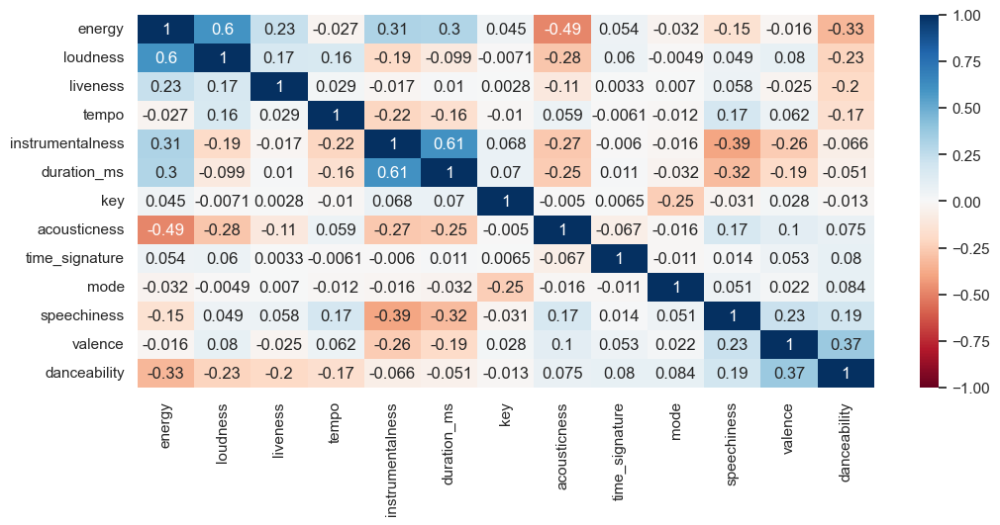

In [9]:
plt.figure(figsize=(12,5), dpi=100)

sns.heatmap(df[
    np.array(sorted(list(zip(df.corr().values[0], df.columns))))[:,1]
            ].corr(), annot=True, vmin=-1, vmax=1, cmap='RdBu')
plt.show()

we convert genre into integers now

In [6]:
df['genre']=df['genre'].astype('category').cat.codes
df['genre']/=max(df['genre'])
df['genre']-=0.5
df['genre'].describe()

count    42305.000000
mean         0.021098
std          0.312236
min         -0.500000
25%         -0.214286
50%          0.000000
75%          0.285714
max          0.500000
Name: genre, dtype: float64

here we use PCA to convert the 13 features into
13 new and more important dimensions

the first and last component have a x4.3 difference in std which suggests
that all 13 dimensions are relevant and can't be dropped without a huge loss of data

In [11]:
pca_module = PCA()
pca_module.fit(df)
pca_comp=pca_module.transform(df)
pca_comp=pd.DataFrame(pca_comp).set_index(df.index)
pca_comp.describe()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
count,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04
mean,1.074926e-17,4.299703e-17,-1.343657e-17,-3.359143e-18,-2.015486e-18,4.534843e-17,-5.105897e-17,-1.234485e-17,1.007743e-17,-8.649793e-18,8.901729e-18,-1.570399e-17,1.612389e-17,3.779036e-18
std,5.252045e-01,5.018060e-01,3.544920e-01,3.185323e-01,2.973937e-01,2.513088e-01,2.352979e-01,2.181408e-01,1.968859e-01,1.931452e-01,1.841550e-01,1.748211e-01,1.590703e-01,1.145718e-01
min,-1.227924e+00,-1.095185e+00,-1.096440e+00,-9.159672e-01,-9.271611e-01,-8.573081e-01,-6.332320e-01,-5.519283e-01,-7.778161e-01,-7.437948e-01,-9.212098e-01,-7.049926e-01,-7.620067e-01,-6.766915e-01
25%,-4.515234e-01,-3.345090e-01,-2.497756e-01,-2.547173e-01,-2.020268e-01,-1.750295e-01,-1.691549e-01,-1.478734e-01,-1.090533e-01,-1.153126e-01,-7.158314e-02,-1.117715e-01,-1.014477e-01,-7.312805e-02
50%,-2.417594e-02,-4.094735e-02,1.310669e-03,1.441051e-02,3.137687e-03,-9.638322e-03,-6.152098e-03,-3.407636e-02,-6.498282e-03,-9.809780e-03,-5.543727e-03,-1.587995e-03,-2.603557e-04,1.280207e-03
75%,3.816423e-01,4.317326e-01,2.307059e-01,2.491559e-01,2.007336e-01,1.758632e-01,1.410131e-01,1.103585e-01,9.456005e-02,1.017240e-01,6.269212e-02,1.129678e-01,1.018921e-01,7.337042e-02
max,1.258157e+00,1.152504e+00,1.513189e+00,9.616533e-01,1.092898e+00,1.151811e+00,1.122169e+00,1.039220e+00,1.405442e+00,1.270126e+00,1.329894e+00,1.056043e+00,7.666847e-01,8.682494e-01


before going any further, we try to visualize the first 3 components with genre in mind
while this is not a clustering of any form, it shows a good distinction (to a limited extend)

In [12]:
fig = px.scatter_3d(pca_comp, x=0, y=1, z=2,
        color=df_genre.loc[df_genre.index.isin(pca_comp.index)], width=600, height=400)
fig.update_traces(marker={'size': 1, 'opacity': 0.5})
fig.show()

due to the unusual separation of the data points, I decided to reconstruct the initial data
without the second component and compare it with the original data.
the separation seems to be mostly due to 'mode' feature and a few other things

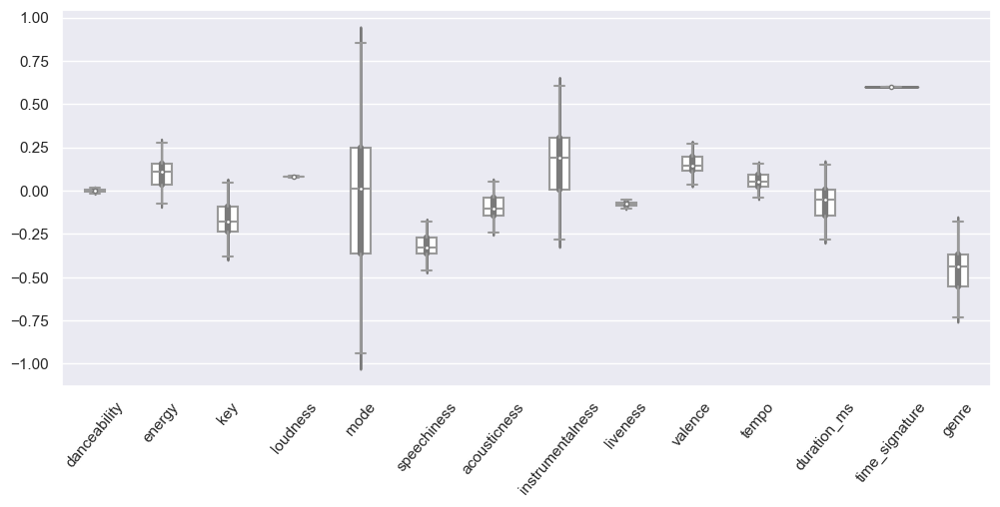

In [13]:
n_df=df-pd.DataFrame(np.array([a+np.mean(df, axis=0)[i if i==0 else i-1]
    for i,a in enumerate(np.dot(np.delete(pca_comp.values, 1, axis=1),
                         np.delete(pca_module.components_, 1, axis=0)).T)]).T,
    columns=df.columns).set_index(df.index)

plt.figure(figsize=(12,5), dpi=100)
sns.set(style="darkgrid")
sns.violinplot(data=n_df, palette="Pastel1", width=0.8)
sns.boxplot(data=n_df, color="white", width=0.3)
plt.xticks(rotation=50)
del n_df
plt.show()

before any clustering, we use tsen to get a overall visualiztion of our data

grouping points by genre seems to not be a great clustering method

In [19]:
def get_tsne(df_u):
    tsne_module = TSNE(n_components=3, n_iter=2000)
    sampled_df=df_u.sample(n=6000).drop_duplicates()
    tsne_results = tsne_module.fit_transform(sampled_df)
    tsne_results=pd.DataFrame(tsne_results).set_index(sampled_df.index)
    del sampled_df
    tsne_results.describe()
    return tsne_results
tsne_results=get_tsne(pca_comp)

D:\Ext. App Files\Code\Py\DataScience\Venv_Conda\Lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

D:\Ext. App Files\Code\Py\DataScience\Venv_Conda\Lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [20]:
def show_tsne(df_u, label_v):
    label_df = {b: a for a, b in zip(label_v, df.index)}
    label_df = [label_df[i] for i in df_u.index]
    fig = px.scatter_3d(df_u,
                        x=0, y=1, z=2, width=600, height=400, color=label_df,
                        color_discrete_sequence=px.colors.qualitative.Antique
                     )
    fig.update_traces(marker={'size': 1.3})
    del label_df
    fig.show()
show_tsne(tsne_results, df_genre.values)

now for clustering.
first we'll use k means simply because its more accessible
after searching and using silhouette, we arrive at a cluster count of 20
k means shouldn't perform too greatly as it is sensitive to outliers and skewed data
which is abundant here.

we can not remove these outliers and skewed data because as explained before, 
many of our samples are described by how different they are from the mean 
(like psytrancec in instrementliness)

In [16]:
sampled_df=pca_comp.sample(n=10000, random_state=1).drop_duplicates()
[(metrics.silhouette_score(sampled_df, KMeans(i).fit(sampled_df).labels_), i)
    for i in range(2,50,4)]

[(0.21536365680739433, 2),
 (0.17018666288971634, 6),
 (0.15073040093762752, 10),
 (0.13390800341011527, 14),
 (0.12128365894016434, 18),
 (0.1281654681439328, 22),
 (0.12293986825292176, 26),
 (0.12773931800366675, 30),
 (0.12902078416608245, 34),
 (0.12912760520023236, 38),
 (0.13002441629738992, 42),
 (0.12985306346979958, 46)]

In [17]:
clustered_db = KMeans(13).fit(pca_comp)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_comp, clustered_db.labels_))

Silhouette Coefficient: 0.144


In [18]:
print(pd.Series(clustered_db.labels_).value_counts()[:8])
show_tsne(tsne_results, clustered_db.labels_)

11    6649
6     4314
9     4041
1     3772
3     3642
10    3458
2     3450
8     2932
dtype: int64


Agglomerative Clustering is used here as it can classify non-linear data
but similar to kmeans, we need to declare the number of clusters.
after searcching the spacec of possible clcuster ccounts, 32 seems to fit well.


In [19]:
sampled_df=pca_comp.sample(n=10000, random_state=1).drop_duplicates()
[(metrics.silhouette_score(sampled_df, AgglomerativeClustering(i).fit(sampled_df).labels_), i)
    for i in range(2,50,4)]

[(0.1711514106252162, 2),
 (0.17300127689867964, 6),
 (0.14712864176514634, 10),
 (0.1215553553861047, 14),
 (0.0937864389970102, 18),
 (0.08594072635304485, 22),
 (0.07677279501848597, 26),
 (0.07842927546741948, 30),
 (0.07663291710773067, 34),
 (0.07767702376902712, 38),
 (0.08218653967935556, 42),
 (0.08264444773669688, 46)]

In [20]:
clustered_db = AgglomerativeClustering(14).fit(pca_comp)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_comp, clustered_db.labels_))

Silhouette Coefficient: 0.124


In [21]:
print(pd.Series(clustered_db.labels_).value_counts()[:8])
show_tsne(tsne_results, clustered_db.labels_)

0     6678
2     4695
3     4619
4     4554
5     4199
10    4045
8     3536
6     3202
dtype: int64


finally, we'll use DBsacn. our data is clamped together and as a result a good
 clustering might not be possible

In [22]:
sampled_df=pca_comp.sample(n=10000, random_state=1).drop_duplicates()
cluster_count=[]
for x in range(1,20,1):
    try:
        cluster_count.append((metrics.silhouette_score(sampled_df,
                        DBSCAN(x/10).fit(sampled_df).labels_), x/10))
    except: pass
cluster_count

[(-0.30842768755243816, 0.2),
 (-0.358742860968752, 0.3),
 (-0.2945296448621617, 0.4),
 (0.001943764276065767, 0.5),
 (0.09029832796431318, 0.6),
 (0.1623886414360071, 0.7),
 (0.21478469966771582, 0.8),
 (0.21652249070838206, 0.9),
 (0.21724805975803893, 1.0),
 (0.3336420044541344, 1.1)]

In [23]:
clustered_db = DBSCAN(0.8).fit(pca_comp)

print("Estimated number of clusters: %d"
      % (len(set(clustered_db.labels_)) - (1 if -1 in clustered_db.labels_ else 0)))
print("Estimated number of noise points: %d" % list(clustered_db.labels_).count(-1))
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_comp, clustered_db.labels_))

Estimated number of clusters: 6
Estimated number of noise points: 42
Silhouette Coefficient: 0.211


In [24]:
print(pd.Series(clustered_db.labels_).value_counts()[:8])
show_tsne(tsne_results, clustered_db.labels_)

 0    22446
 2    18479
 1      765
 3      562
-1       42
 5        7
 4        4
dtype: int64


now due to the bad performance, we'll remove unnecessary columns and try again.
this columns incclude: mode, key and time signature which skew the data universally and equally

a few of the features have also been scaled to make k-means better
red plot show the previous values

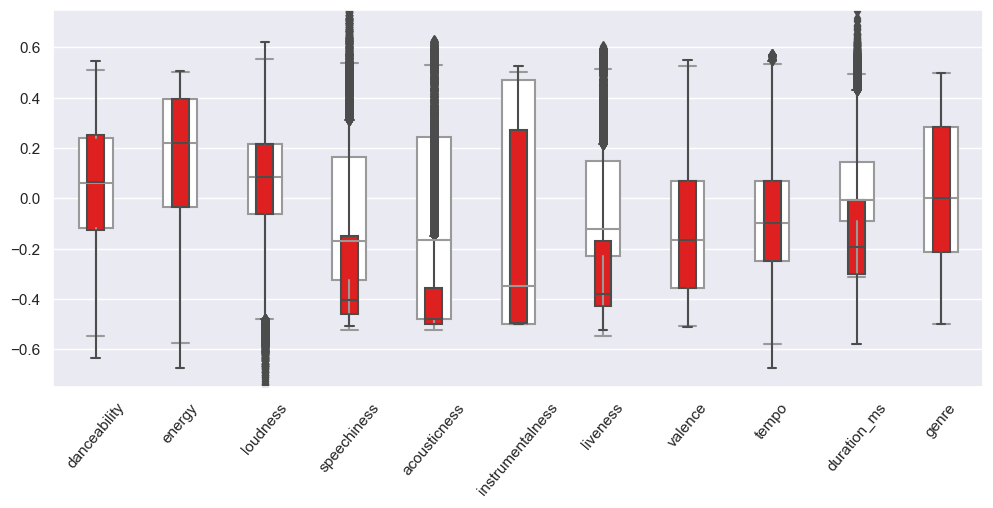

In [7]:
df_new=df.copy()
df_new.drop(['mode','time_signature', 'key'],
            axis=1,inplace=True)
f = lambda v: np.sign(v)*math.log(abs(v*16)+1,5)/1.76
df_new['danceability']=df['danceability']*0.95
df_new['speechiness']=-0.5+(df['speechiness']+0.5).apply(f)
df_new['acousticness']=-0.25+(df['acousticness']+0.5).apply(f).apply(f)*1.1-0.3
df_new['instrumentalness']=-0.5+(df['instrumentalness']+0.5).apply(f).apply(f)
df_new['liveness']=-0.5+(df['liveness']+0.5).apply(f)
df_new['duration_ms']=df['duration_ms']*0.8+0.15
df_new=df_new.apply(lambda col: col.apply(lambda v: v if np.isscalar(v) and max_v>=v>=min_v
                                        else np.sign(v)*math.log(abs(v*8)+1,5)/2))

plt.figure(figsize=(12,5), dpi=100)
sns.set(style="darkgrid")
x=df_genre
sns.boxplot(data=df_new, color="white", width=0.4)
sns.boxplot(data=df.drop(['mode','time_signature', 'key'],axis=1), color="red", width=0.2)
plt.xticks(rotation=50)
plt.ylim(min_v-0.25,max_v+0.25)
plt.show()



In [8]:
pca_module = PCA()
pca_module.fit(df_new)
pca_comp=pca_module.transform(df_new)
pca_comp=pd.DataFrame(pca_comp).set_index(df_new.index)

fig = px.scatter_3d(pca_comp, x=0, y=1, z=2, width=600, height=400,
        color=df_genre.loc[df_genre.index.isin(pca_comp.index)], )
fig.update_traces(marker={'size': 1, 'opacity': 0.7})
fig.show()

pca_comp.describe()

,0,1,2,3,4,5,6,7,8,9,10
count,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04
mean,-2.015486e-17,-2.687314e-18,-2.687314e-18,-2.284217e-17,4.366886e-18,9.405601e-18,1.948303e-17,1.801340e-17,6.382372e-18,1.511614e-18,1.763550e-17
std,5.993911e-01,3.599820e-01,3.013336e-01,2.594195e-01,2.456959e-01,2.333157e-01,2.236380e-01,1.929512e-01,1.622768e-01,1.508688e-01,1.145487e-01
min,-1.064664e+00,-1.051940e+00,-9.594363e-01,-9.807200e-01,-8.390388e-01,-8.780839e-01,-7.761110e-01,-7.512306e-01,-7.580765e-01,-5.586901e-01,-6.882120e-01
25%,-5.995989e-01,-2.410582e-01,-2.084956e-01,-1.665521e-01,-1.689058e-01,-1.502268e-01,-1.547377e-01,-1.180128e-01,-1.086332e-01,-1.024915e-01,-7.244430e-02
50%,6.263196e-02,-6.335879e-03,2.652171e-03,9.011458e-03,-2.976050e-03,-1.409991e-03,-1.120752e-02,-9.571439e-03,-5.117253e-03,-2.361092e-03,-2.431785e-04
75%,5.635208e-01,2.214084e-01,2.062179e-01,1.743040e-01,1.610376e-01,1.463106e-01,1.458022e-01,1.089720e-01,1.041216e-01,9.964064e-02,7.387570e-02
max,1.208253e+00,1.426329e+00,9.862796e-01,9.908759e-01,1.119067e+00,1.136959e+00,9.345115e-01,8.182177e-01,7.934487e-01,7.381226e-01,6.900815e-01


In [72]:
tsne_results=get_tsne(pca_comp)
show_tsne(tsne_results,df_genre.values)

D:\Ext. App Files\Code\Py\DataScience\Venv_Conda\Lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

D:\Ext. App Files\Code\Py\DataScience\Venv_Conda\Lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



now Kmeans once more. here a cluster count of 16 shows best silhouette score.
16 is also close to the number of genres.

In [16]:
sampled_df=pca_comp.sample(n=20000, random_state=1).drop_duplicates()
[(metrics.silhouette_score(sampled_df, KMeans(i).fit(sampled_df).labels_), i)
    for i in range(12,20,1)]

[(0.1384489410336157, 12),
 (0.1400264433253751, 13),
 (0.13962479517185383, 14),
 (0.13968051937878562, 15),
 (0.1407915950399401, 16),
 (0.13887390320486878, 17),
 (0.14060282799043258, 18),
 (0.1408065207193994, 19)]

In [9]:
cluster_module = KMeans(16)
clustered_db=cluster_module.fit(pca_comp)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_comp, clustered_db.labels_))
with open("model.pkl", "wb") as f:
    pickle.dump((cluster_module, clustered_db, pca_module), f)

Silhouette Coefficient: 0.144


In [22]:
print(pd.Series(clustered_db.labels_).value_counts()[:8])
show_tsne(tsne_results, np.array(clustered_db.labels_).astype('str'))

8     4063
2     3788
11    3428
1     3375
7     3280
5     3159
0     2954
12    2675
dtype: int64


and AgglomerativeClustering:


In [53]:
sampled_df=pca_comp.sample(n=10000, random_state=1).drop_duplicates()
[(metrics.silhouette_score(sampled_df, AgglomerativeClustering(i).fit(sampled_df).labels_), i)
    for i in range(2,50,4)]

[(0.2646212762106306, 2),
 (0.1584912263448354, 6),
 (0.09070477880333494, 10),
 (0.08079591160393997, 14),
 (0.0900907459153591, 18),
 (0.07994388139765171, 22),
 (0.06907536654996917, 26),
 (0.06980016536230477, 30),
 (0.07317226911758849, 34),
 (0.07326295026211263, 38),
 (0.07341361830009452, 42),
 (0.07010139016498042, 46)]

In [80]:
clustered_db = AgglomerativeClustering(18).fit(pca_comp)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_comp, clustered_db.labels_))

Silhouette Coefficient: 0.080


In [81]:
print(pd.Series(clustered_db.labels_).value_counts()[:8])
show_tsne(tsne_results, np.array(clustered_db.labels_).astype('str'))

5     3995
6     3845
0     3754
2     3394
8     3176
10    2958
3     2876
7     2258
dtype: int64


and finally DBSCAN

In [52]:
sampled_df=pca_comp.sample(n=10000, random_state=1).drop_duplicates()
cluster_count=[]
for x in range(1,20,1):
    try:
        cluster_count.append((metrics.silhouette_score(sampled_df,
                        DBSCAN(x/10).fit(sampled_df).labels_), x/10))
    except: pass
cluster_count

[(-0.32207275406835256, 0.2),
 (-0.4326862851574881, 0.3),
 (-0.13532278119601496, 0.4),
 (0.0941538302012302, 0.5),
 (0.13229484161813704, 0.6),
 (0.19568885243196535, 0.7)]

In [64]:
clustered_db = DBSCAN(0.45).fit(pca_comp)

print("Estimated number of clusters: %d"
      % (len(set(clustered_db.labels_)) - (1 if -1 in clustered_db.labels_ else 0)))
print("Estimated number of noise points: %d" % list(clustered_db.labels_).count(-1))
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_comp, clustered_db.labels_))

Estimated number of clusters: 108
Estimated number of noise points: 10056
Silhouette Coefficient: -0.494


In [65]:
print(pd.Series(clustered_db.labels_).value_counts()[:8])
show_tsne(tsne_results, np.array(clustered_db.labels_).astype('str'))

 0     31636
-1     10056
 6        19
 99       17
 18       15
 91       12
 12       12
 4        10
dtype: int64
